In [1]:
%pip install comet_ml


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 780.9/780.9 kB 42.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 54.3 MB/s eta 0:00:00
  Attempting uninstall: python-box
    Found existing installation: python-box 7.3.2
    Uninstalling python-box-7.3.2:
      Successfully uninstalled python-box-7.3.2


In [2]:
import comet_ml
from comet_ml.integration.pytorch import log_model, watch
from tqdm import tqdm

import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import torch.backends.cudnn as cudnn
import torch.nn.functional as F
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import time
import os
from PIL import Image
from tempfile import TemporaryDirectory
from google.colab import drive
import random
from collections import Counter
from torch.utils.data import DataLoader, WeightedRandomSampler
from google.colab import userdata
import pandas as pd
import seaborn as sns


In [3]:

# Retrieve the key from Colab Secrets
api_key = userdata.get('COMET_API_KEY')

# Log in and
comet_ml.login(api_key=api_key, project_name="chess-piece-recognition")


COMET INFO: Valid Comet API Key saved in /content/drive/MyDrive/.comet.config (set COMET_CONFIG to change where it is saved).


In [4]:
cudnn.benchmark = True # enable choosing the best algorithms for my hardware and input size


### Load the Data:

In [5]:
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [6]:
!unzip /content/drive/MyDrive/Deep_Learning_Project/dataset.zip -d /content/data #extract the data from the drive zip to the virtual file system


Streaming output truncated to the last 5000 lines.
  inflating: /content/data/dataset/val/black_bishop/game7_frame_018136_a6.jpg  
  inflating: /content/data/dataset/val/black_bishop/game7_frame_000428_f8.jpg  
  inflating: /content/data/dataset/val/black_bishop/game7_frame_031396_a6.jpg  
  inflating: /content/data/dataset/val/black_bishop/game7_frame_031296_a6.jpg  
  inflating: /content/data/dataset/val/black_bishop/game7_frame_002700_d6.jpg  
  inflating: /content/data/dataset/val/black_bishop/game7_frame_017092_d6.jpg  
  inflating: /content/data/dataset/val/black_bishop/game7_frame_016032_d6.jpg  
  inflating: /content/data/dataset/val/black_bishop/game7_frame_000736_c8.jpg  
  inflating: /content/data/dataset/val/black_bishop/game7_frame_016920_a6.jpg  
  inflating: /content/data/dataset/val/black_bishop/game7_frame_026756_b4.jpg  
  inflating: /content/data/dataset/val/black_bishop/game7_frame_000760_f8.jpg  
  inflating: /content/data/dataset/val/black_bishop/game7_frame_02176

In [7]:
# Data augmentation and normalization for training
# Just normalization for validation and test

imagenet_mean = [0.485, 0.456, 0.406]
imagenet_std = [0.229, 0.224, 0.225]
data_transforms = {
    'train': transforms.Compose([
        transforms.Resize(224),
        transforms.RandomHorizontalFlip(),
        transforms.RandomVerticalFlip(),
        transforms.ToTensor(),
        transforms.Normalize(imagenet_mean,imagenet_std)
    ]),
    'val': transforms.Compose([
        transforms.Resize(224),
        transforms.ToTensor(),
        transforms.Normalize(imagenet_mean, imagenet_std)
    ]),

}

data_dir = '/content/data/dataset'
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'val']}



dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val']}

class_names = image_datasets['train'].classes

### visualize data **distribution**

In [8]:
def get_dataset_histogram(dataset):
  idx_to_class = {idx: cls for cls, idx in dataset.class_to_idx.items()}
  counts = Counter(dataset.targets)
  histogram = {idx_to_class[idx]: count for idx, count in counts.items()}
  return histogram

def to_dist(dataset_histo):
  dataset_size = sum(dataset_histo.values())
  return {cls: count / dataset_size for cls, count in dataset_histo.items()}


def plot_dataset_histo(train_histo, val_histo, as_dist = False, y_lim = None):

  piece_types = ['pawn', 'knight', 'bishop', 'rook', 'queen', 'king']

  if as_dist:
      train_histo = to_dist(train_histo)
      val_histo = to_dist(val_histo)

  white_counts_train = [train_histo.get(f'white_{p}') for p in piece_types]
  black_counts_train = [train_histo.get(f'black_{p}') for p in piece_types]
  empty_count_train = train_histo.get('empty')

  white_counts_val = [val_histo.get(f'white_{p}') for p in piece_types]
  black_counts_val = [val_histo.get(f'black_{p}') for p in piece_types]
  empty_count_val = val_histo.get('empty')

  # Set up x-axis indices
  x = np.arange(len(piece_types))
  width = 0.2  # Width of each grouped bar

  fig, ax = plt.subplots(figsize=(12, 6))

  # 1. Draw grouped bars for pieces
  ax.bar(x - 1.5*width, white_counts_train, width, label='Train White', color='#f0d9b5', edgecolor='gray')
  ax.bar(x - 0.5*width, black_counts_train, width, label='Train Black', color='#b58863', edgecolor='gray')
  ax.bar(x + 0.5*width, white_counts_val, width, label='Val White', color='#d5e1df', edgecolor='blue', alpha=0.7)
  ax.bar(x + 1.5*width, black_counts_val, width, label='Val Black', color='#635a52', edgecolor='blue', alpha=0.7)


  # 2. Draw single bar for the 'Empty' class at the end
  empty_pos = len(piece_types)
  ax.bar(empty_pos - 0.5*width, empty_count_train, width*2, label='Train Empty', color='#769656', edgecolor='gray')
  ax.bar(empty_pos + 0.5*width, empty_count_val, width*2, label='Val Empty', color='#4a6136', edgecolor='blue', alpha=0.7)


  # Formatting the graph
  if as_dist:
    ax.set_title('Distribution of Test vs Validation', fontsize=14, fontweight='bold')
    ax.set_ylabel('Frequency')

  else:
    ax.set_title('Histogram of Test vs Validation', fontsize=14, fontweight='bold')
    ax.set_ylabel('Count')

  # Set x-ticks to match piece types + the empty cell
  ax.set_xticks(list(x) + [empty_pos])
  ax.set_xticklabels([p.capitalize() for p in piece_types] + ['Empty'])

  if as_dist:
    ax.set_ylim(0, 1)

  ax.set_ylim(y_lim)
  ax.legend()
  plt.grid(axis='y', linestyle='--', alpha=0.7)
  plt.tight_layout()
  plt.show()


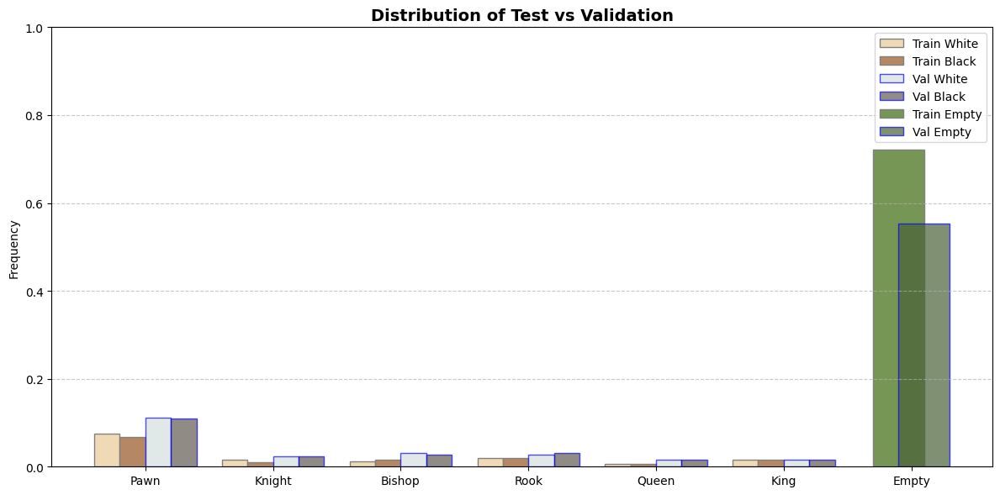

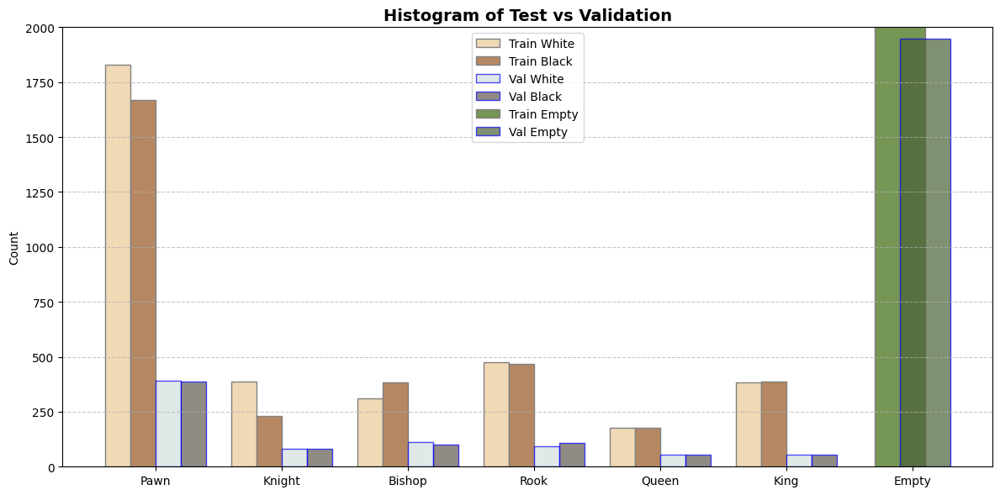

In [9]:
train_histo = get_dataset_histogram(image_datasets['train'])
val_histo = get_dataset_histogram(image_datasets['val'])
plot_dataset_histo(train_histo, val_histo,as_dist=True)


train_histo = get_dataset_histogram(image_datasets['train'])
val_histo = get_dataset_histogram(image_datasets['val'])
plot_dataset_histo(train_histo, val_histo,as_dist=False,y_lim=(0,2000))



## Balancing The Datasets

### options:
1. filtering   
2. loss weight
3. **loader probailities**




In [10]:


def visualise_dataloader_batches(dataloader, n, as_dist=False, y_lim=None):
    """Plot classes histograms of the first n batches of the dataloader"""
    idx_to_class = {idx: cls for cls, idx in image_datasets['train'].class_to_idx.items()}
    for i, (images, labels) in enumerate(dataloader):
        if i < n:

            labels_count = Counter(labels.tolist()) # Convert tensor to list for Counter
            cls_count = {idx_to_class[idx]: count for idx, count in labels_count.items()}

            plot_histo(cls_count, f"Counts of Batch {i}", as_dist, y_lim)
        else:
            break

def visualise_dataloader_batch_mean(dataloader, as_dist=False, y_lim=None):
  """Plot classes mean histogram of the dataloader epoch"""
  idx_to_class = {idx: cls for cls, idx in image_datasets['train'].class_to_idx.items()}
  cls_count = {cls: 0 for cls in class_names}
  num_batches = 0
  for images, labels in dataloader:
      labels_count = Counter(labels.tolist()) # Convert tensor to list for Counter
      num_batches += 1

      for idx, count in labels_count.items():
          cls_count[idx_to_class[idx]] += count

  cls_count = {cls: count / (num_batches) for cls, count in cls_count.items()}
  plot_histo(cls_count, f"Mean Counts of Batches", as_dist, y_lim)



def plot_histo(histo, title, as_dist=False, y_lim=None):
    piece_types = ['pawn', 'knight', 'bishop', 'rook', 'queen', 'king']

    if as_dist:
        total = sum(histo.values())
        histo = {k: v / total for k, v in histo.items()}

    white_counts = [histo.get(f'white_{p}', 0) for p in piece_types]
    black_counts = [histo.get(f'black_{p}', 0) for p in piece_types]
    empty_count = histo.get('empty', 0)

    x = np.arange(len(piece_types))
    width = 0.3

    fig, ax = plt.subplots(figsize=(12, 6))

    # Draw grouped bars
    ax.bar(x - width/2, white_counts, width, label='White', color='#f0d9b5', edgecolor='gray')
    ax.bar(x + width/2, black_counts, width, label='Black', color='#b58863', edgecolor='gray')

    # Draw single bar for 'Empty'
    empty_pos = len(piece_types)
    ax.bar(empty_pos, empty_count, width*1.5, label='Empty', color='#769656', edgecolor='gray')

    ax.set_title(title, fontsize=14, fontweight='bold')
    ax.set_ylabel('Frequency' if as_dist else 'Count')
    ax.set_xticks(list(x) + [empty_pos])
    ax.set_xticklabels([p.capitalize() for p in piece_types] + ['Empty'])

    if y_lim:
        ax.set_ylim(y_lim)
    elif as_dist:
        ax.set_ylim(0, 1)

    ax.legend()
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()




In [11]:
BATCH_SIZE = 16

In [12]:
def create_weighted_sampler(dataset, num_samples = None):
    # 1. Get class counts (from previous function)
    counts = Counter(dataset.targets)
    class_counts = np.array([counts[i] for i in range(len(counts))])

    # 2. Calculate inverse frequency weights
    # Rare classes get higher weights; frequent classes get lower weights
    weights = 1. / class_counts

    # 3. Create a list of weights for every single image in the dataset
    sample_weights = weights[dataset.targets]
    sample_weights = torch.from_numpy(sample_weights).double()

    # 4. Create the sampler
    if num_samples is None:
        num_samples = len(dataset)
    sampler = WeightedRandomSampler(
        sample_weights,
        num_samples = num_samples,
        replacement=True # Sample with replacement to ensure equal probability
    )
    return sampler

### no weighted sampler:

In [13]:
imbalanced_dataloaders = {x: DataLoader(image_datasets[x], batch_size=BATCH_SIZE, num_workers=2,shuffle=True)
              for x in ['train', 'val']}

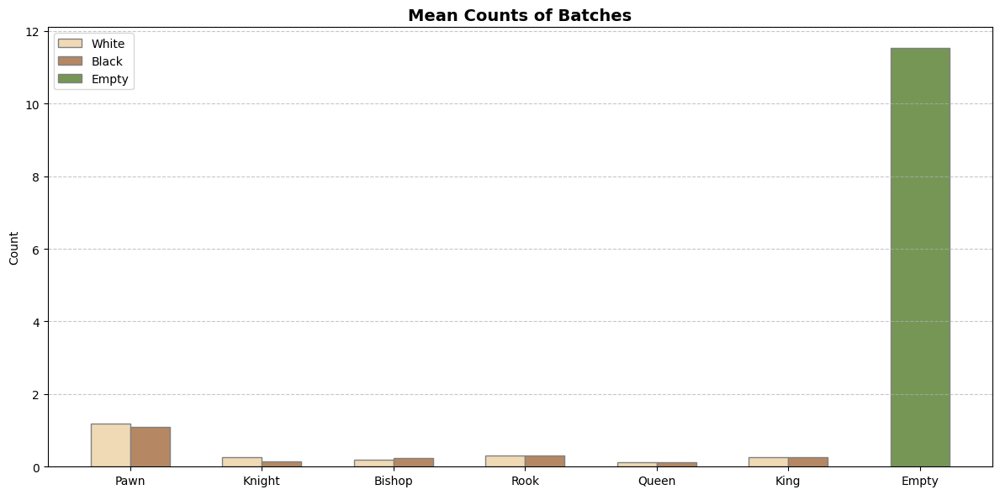

In [14]:

visualise_dataloader_batch_mean(imbalanced_dataloaders['train'])


### with weighted sampler:

In [15]:
dataloaders = {x: DataLoader(image_datasets[x], batch_size=BATCH_SIZE, num_workers=2, sampler=create_weighted_sampler(image_datasets[x]))
              for x in ['train', 'val']}

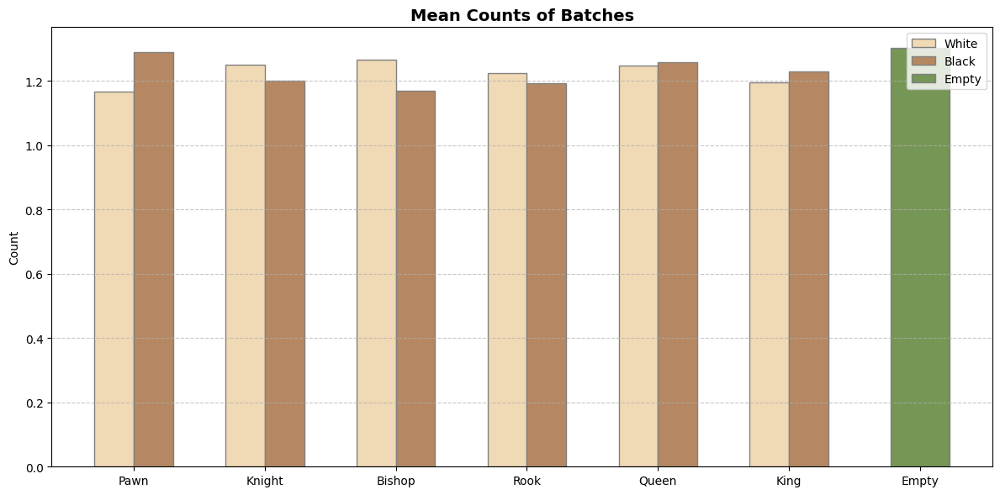

In [16]:
visualise_dataloader_batch_mean(dataloaders['train'])

In [17]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using {device} device")

Using cuda device


### Display a sample from each class of the training data

In [18]:
def tensor_to_numpy_image(image):
    """transform tensor to diplayable numpy image."""
    image = image.numpy().transpose((1, 2, 0))
    image = imagenet_std * image + imagenet_mean
    image = image.clip(0,1)
    return image



In [19]:
def plot_dataset_sample(N, dataset, dataset_name):
    num_classes = len(dataset.classes)
    fig, axes = plt.subplots(
        num_classes, N,
        figsize=(N * 2, num_classes * 2)
    )
    fig.suptitle('Random Samples from Each Class', y = 1.0, fontsize=25)


    for row, cls in enumerate(dataset.classes):
        cls_idx = dataset.class_to_idx[cls]
        candidates_idxs = [
            i for i, (_, label) in enumerate(dataset.samples)
            if label == cls_idx
        ]
        sample_idxs = random.sample(candidates_idxs, N)
        for col,i in enumerate(sample_idxs):
            image, _ = dataset[i]
            image = tensor_to_numpy_image(image)
            ax = axes[row, col]
            ax.imshow(image)
            ax.set_xticks([])
            ax.set_yticks([])


        axes[row, 0].set_ylabel(cls, fontsize=20)

    plt.tight_layout()
    plt.show()


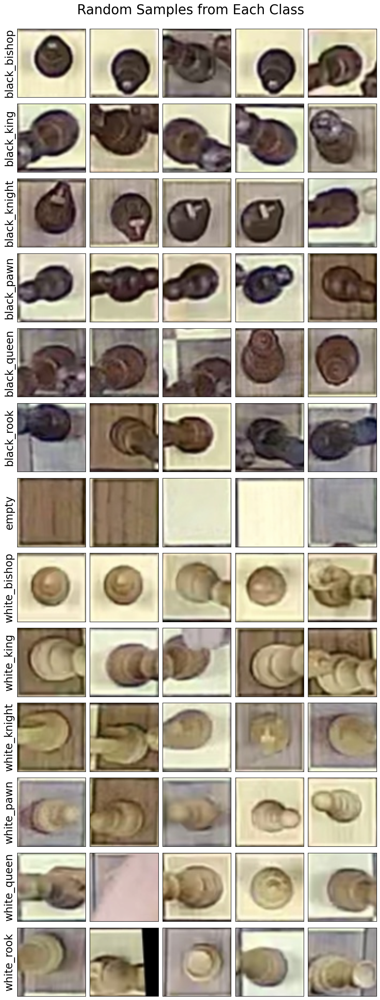

In [20]:
plot_dataset_sample(5, image_datasets['train'], 'train')

### Training Function

In [21]:
def train_model(model, criterion, optimizer, scheduler,experiment, num_epochs=25, patience=25,log_per_batch_metrics = False):
    since = time.time()

    with TemporaryDirectory() as tempdir:
        best_model_params_path = os.path.join(tempdir, 'best_model_params.pt')
        torch.save(model.state_dict(), best_model_params_path)
        best_acc = 0.0
        epochs_without_improvement = 0 # Counter for early stopping


        for epoch in range(num_epochs):
            print(f'Epoch {epoch}/{num_epochs - 1}')

            for phase in ['train', 'val']:
                epoch_size = 0;

                if phase == 'train':
                    model.train()
                else:
                    model.eval()

                running_loss = 0.0
                running_corrects = 0

                for inputs, labels in dataloaders[phase]:
                    inputs = inputs.to(device)
                    labels = labels.to(device)

                    optimizer.zero_grad()

                    with torch.set_grad_enabled(phase == 'train'):
                        outputs = model(inputs)
                        _, preds = torch.max(outputs, 1)
                        loss = criterion(outputs, labels)

                        if phase == 'train':
                            loss.backward()
                            optimizer.step()
                    if log_per_batch_metrics:
                        experiment.log_metrics({
                            f"{phase}_batch_loss": loss.item(),
                            f"{phase}_batch_acc": (preds == labels.data).double().mean().item()
                        })
                    epoch_size += inputs.size(0)
                    running_loss += loss.item() * inputs.size(0)
                    running_corrects += torch.sum(preds == labels.data)

                if phase == 'train':
                    scheduler.step()

                # Calculate metrics for the epoch
                epoch_loss = running_loss / epoch_size
                epoch_acc = running_corrects.double() / epoch_size

                # step=epoch ensures the graph aligns correctly on the x-axis
                experiment.log_metrics({
                    f"{phase}_loss": epoch_loss,
                    f"{phase}_acc": epoch_acc
                }, step=epoch)

                print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

                # deep copy the model
                if phase == 'val':
                    if epoch_acc > best_acc:
                        best_acc = epoch_acc
                        # Reset counter since we found a better model
                        epochs_without_improvement = 0
                        torch.save(model.state_dict(), best_model_params_path)
                    else:
                        # Increment counter if no improvement was made
                        epochs_without_improvement += 1

            print()

            #Check if patience limit is reached
            if epochs_without_improvement >= patience:
                print(f"Early stopping triggered after {patience} epochs without improvement!")
                break # Exit the main epoch loop


        time_elapsed = time.time() - since
        print(f'Best val Acc: {best_acc:4f}')

        model.load_state_dict(torch.load(best_model_params_path, weights_only=True))

        # --- NEW: End experiment after training ---
        experiment.end()

    return model




### Model Training


1. resnet18-finetuned

In [ ]:
experiment = comet_ml.start()
experiment.set_name("resnet18_ft")
experiment.auto_metric_logging = False

model_ft = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)
num_ftrs = model_ft.fc.in_features

model_ft.fc = nn.Linear(num_ftrs, len(class_names))

model_ft = model_ft.to(device)

criterion = nn.CrossEntropyLoss()

# all parameters are being optimized
optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)
model_ft = train_model(
    model_ft,
    criterion,
    optimizer_ft,
    exp_lr_scheduler,
    experiment,
    num_epochs=100,
    patience=10,
    log_per_batch_metrics=True
)

# torch.save(model_ft.state_dict(), "resnet18_ft.pth")
experiment.end()

COMET WARNING: As you are running in a Jupyter environment, you will need to call `experiment.end()` when finished to ensure all metrics and code are logged before exiting.
COMET INFO: Experiment is live on comet.com https://www.comet.com/david-p-1361/chess-piece-recognition/80c56b8c393b45719822e59f1a57a464

COMET INFO: Couldn't find a Git repository in '/content' nor in any parent directory. Set `COMET_GIT_DIRECTORY` if your Git Repository is elsewhere.


Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


100%|██████████| 44.7M/44.7M [00:00<00:00, 121MB/s]


Epoch 0/99
train Loss: 0.3404 Acc: 0.8989
val Loss: 0.6537 Acc: 0.8643

Epoch 1/99


KeyboardInterrupt: 

shorter epochs

In [ ]:

histos = {x: get_dataset_histogram(image_datasets[x]) for x in ['train','val']}
num_classes = len(class_names)
average_without_empty = {x: (sum(histos[x].values()) - histos[x]['empty'])//(num_classes-1) for x in ['train','val']}
samples_num = {x: average_without_empty[x] * num_classes for x in ['train','val']}

for x in ['train','val']:
  print(f"{x}: {samples_num[x]}")

dataloaders = {x: DataLoader(image_datasets[x], batch_size=BATCH_SIZE, num_workers=2,
              sampler=create_weighted_sampler(image_datasets[x],samples_num[x]))
              for x in ['train', 'val']}

experiment = comet_ml.start()
experiment.set_name("resnet18_ft_short_epochs")
experiment.auto_metric_logging = False

model_ft = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)
num_ftrs = model_ft.fc.in_features

model_ft.fc = nn.Linear(num_ftrs, len(class_names))

model_ft = model_ft.to(device)

criterion = nn.CrossEntropyLoss()

# all parameters are being optimized
optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)
model_ft = train_model(
    model_ft,
    criterion,
    optimizer_ft,
    exp_lr_scheduler,
    experiment,
    num_epochs=100,
    patience=10
)

experiment.end()


COMET INFO: An experiment with the same configuration options is already running and will be reused.


train: 7436
val: 1703
Epoch 0/99
train Loss: 0.8120 Acc: 0.7454
val Loss: 0.7691 Acc: 0.8062

Epoch 1/99
train Loss: 0.1822 Acc: 0.9540
val Loss: 0.5804 Acc: 0.8685

Epoch 2/99
train Loss: 0.1185 Acc: 0.9704
val Loss: 0.9664 Acc: 0.7980

Epoch 3/99
train Loss: 0.0887 Acc: 0.9778
val Loss: 0.5385 Acc: 0.8820

Epoch 4/99
train Loss: 0.0772 Acc: 0.9808
val Loss: 0.5955 Acc: 0.8714

Epoch 5/99
train Loss: 0.0631 Acc: 0.9843
val Loss: 0.6721 Acc: 0.8878

Epoch 6/99
train Loss: 0.0521 Acc: 0.9875
val Loss: 0.4882 Acc: 0.8714

Epoch 7/99
train Loss: 0.0474 Acc: 0.9876
val Loss: 0.5002 Acc: 0.8837

Epoch 8/99
train Loss: 0.0447 Acc: 0.9886
val Loss: 0.5898 Acc: 0.8708

Epoch 9/99
train Loss: 0.0375 Acc: 0.9903
val Loss: 0.6420 Acc: 0.8720

Epoch 10/99
train Loss: 0.0427 Acc: 0.9888
val Loss: 0.7343 Acc: 0.8738

Epoch 11/99
train Loss: 0.0410 Acc: 0.9899
val Loss: 0.6404 Acc: 0.8773

Epoch 12/99
train Loss: 0.0456 Acc: 0.9902
val Loss: 0.5325 Acc: 0.8843

Epoch 13/99
train Loss: 0.0337 Acc: 0.9

COMET WARNING: Couldn't retrieve and log Google Colab notebook content, reason: 'NoneType' object is not subscriptable
COMET INFO: ---------------------------------------------------------------------------------------
COMET INFO: Comet.ml Experiment Summary
COMET INFO: ---------------------------------------------------------------------------------------
COMET INFO:   Data:
COMET INFO:     display_summary_level : 1
COMET INFO:     name                  : resnet18_ft_short_epochs
COMET INFO:     url                   : https://www.comet.com/david-p-1361/chess-piece-recognition/7885238568554d16bc995b91046e7c38
COMET INFO:   Metrics [count] (min, max):
COMET INFO:     train_acc [44]  : (0.7409897794513178, 0.9926035502958579)
COMET INFO:     train_loss [44] : (0.0294012409945997, 0.8273592944617166)
COMET INFO:     val_acc [44]    : (0.15395557500820659, 0.8907809747504404)
COMET INFO:     val_loss [44]   : (0.07670698709242166, 0.9663749628919611)
COMET INFO:   Others:
COMET INFO:     

2. resnet18 - transfer learning

In [ ]:
experiment = comet_ml.start()
experiment.set_name("resnet18_trans")
experiment.auto_metric_logging = False

model_conv = torchvision.models.resnet18(weights=models.ResNet18_Weights.DEFAULT)
for param in model_conv.parameters():
    param.requires_grad = False

# Parameters of newly constructed modules have requires_grad=True by default
num_ftrs = model_conv.fc.in_features
model_conv.fc = nn.Linear(num_ftrs, len(class_names))

model_conv = model_conv.to(device)

criterion = nn.CrossEntropyLoss()

# Observe that only parameters of final layer are being optimized as
# opposed to before.
optimizer_conv = optim.SGD(model_conv.fc.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_conv, step_size=7, gamma=0.1)
model_conv = train_model(model_conv, criterion, optimizer_conv, exp_lr_scheduler, experiment,
                         num_epochs=100, patience=10)
torch.save(model_conv.state_dict(), "/content/drive/MyDrive/Deep_Learning_Project/models/resnet18_trans.pth")
experiment.end()

3. Resnet50 - finetuning

In [ ]:
experiment = comet_ml.start()
experiment.set_name("resnet50_ft")
experiment.auto_metric_logging = False

model_ft = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
num_ftrs = model_ft.fc.in_features

model_ft.fc = nn.Linear(num_ftrs, len(class_names))

model_ft = model_ft.to(device)

criterion = nn.CrossEntropyLoss()

# all parameters are being optimized
optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)
model_ft = train_model(model_ft, criterion, optimizer_ft, exp_lr_scheduler, experiment,
                       num_epochs=100, patience=10)

torch.save(model_ft.state_dict(), "/content/drive/MyDrive/Deep_Learning_Project/models/resnet50_ft.pth")
experiment.end()

COMET INFO: An experiment with the same configuration options is already running and will be reused.


Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth


100%|██████████| 97.8M/97.8M [00:00<00:00, 108MB/s]


Epoch 0/99
train Loss: 0.5850 Acc: 0.8230
val Loss: 0.7063 Acc: 0.8484

Epoch 1/99
train Loss: 0.0869 Acc: 0.9766
val Loss: 0.8106 Acc: 0.8702

Epoch 2/99
train Loss: 0.0560 Acc: 0.9848
val Loss: 0.7631 Acc: 0.8796

Epoch 3/99
train Loss: 0.0440 Acc: 0.9884
val Loss: 0.6584 Acc: 0.8773

Epoch 4/99


train Loss: 0.0346 Acc: 0.9902
val Loss: 0.5448 Acc: 0.8657

Epoch 5/99
train Loss: 0.0292 Acc: 0.9915
val Loss: 0.5503 Acc: 0.8748

Epoch 6/99
train Loss: 0.0249 Acc: 0.9928
val Loss: 0.7037 Acc: 0.8768

Epoch 7/99
train Loss: 0.0222 Acc: 0.9938
val Loss: 0.7751 Acc: 0.8657

Epoch 8/99
train Loss: 0.0182 Acc: 0.9949
val Loss: 0.8200 Acc: 0.8731

Epoch 9/99
train Loss: 0.0194 Acc: 0.9943
val Loss: 0.6746 Acc: 0.8748

Epoch 10/99
train Loss: 0.0180 Acc: 0.9948
val Loss: 0.7872 Acc: 0.8722

Epoch 11/99
train Loss: 0.0203 Acc: 0.9938
val Loss: 0.7363 Acc: 0.8691

Epoch 12/99
train Loss: 0.0187 Acc: 0.9940
val Loss: 0.7653 Acc: 0.8683

Early stopping triggered after 10 epochs without improvement!
Best val Acc: 0.879614


COMET WARNING: Couldn't retrieve and log Google Colab notebook content, reason: 'NoneType' object is not subscriptable
COMET INFO: ---------------------------------------------------------------------------------------
COMET INFO: Comet.ml Experiment Summary
COMET INFO: ---------------------------------------------------------------------------------------
COMET INFO:   Data:
COMET INFO:     display_summary_level : 1
COMET INFO:     name                  : resnet50_ft
COMET INFO:     url                   : https://www.comet.com/david-p-1361/chess-piece-recognition/b9e734f27357459db6b8902e1dbfff5d
COMET INFO:   Metrics [count] (min, max):
COMET INFO:     train_acc [13]  : (0.8230257284311339, 0.9949273597922247)
COMET INFO:     train_loss [13] : (0.01802732156613702, 0.5849801505194785)
COMET INFO:     val_acc [13]    : (0.848381601362862, 0.8796138557637706)
COMET INFO:     val_loss [13]   : (0.5447516956714721, 0.819972314639802)
COMET INFO:   Others:
COMET INFO:     Name         : r

VGG16 - transfer

In [ ]:

experiment = comet_ml.start()
experiment.set_name("VGG16-transfer")
experiment.auto_metric_logging = False

model = models.vgg16(weights=models.VGG16_Weights.DEFAULT)

# Freeze convolutional backbone
for param in model.features.parameters():
    param.requires_grad = False

# Replace final classifier layer
model.classifier[6] = nn.Linear(model.classifier[6].in_features, len(class_names))

model = model.to(device)

criterion = nn.CrossEntropyLoss()

# Train only classifier layers (as you intended)
optimizer = optim.Adam(model.classifier.parameters(), lr=0.001)

# Optional scheduler (you can remove if you don’t want one)
scheduler = lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

model = train_model(
    model, criterion, optimizer, scheduler, experiment,
    num_epochs=100, patience=10
)

ckpt_path = "/content/drive/MyDrive/Deep_Learning_Project/models/vgg16_trans.pth"
torch.save(model.state_dict(), ckpt_path)


experiment.end()


COMET WARNING: As you are running in a Jupyter environment, you will need to call `experiment.end()` when finished to ensure all metrics and code are logged before exiting.
COMET INFO: Experiment is live on comet.com https://www.comet.com/david-p-1361/chess-piece-recognition/32eeffec78884bc993ccba7dfebdd4c8

COMET INFO: Couldn't find a Git repository in '/content' nor in any parent directory. Set `COMET_GIT_DIRECTORY` if your Git Repository is elsewhere.


Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


 84%|████████▍ | 444M/528M [00:04<00:00, 121MB/s]

Guess: as we see, we are stuck at 87% validation accuracy, assumption: the 13% precent error is mostly ocluded images. lets use the following function to print out the images in val that the model calssifies wrong, and see if they are indeed ocluded.

lets eval the model only on the clean data set

In [22]:
def compute_val_acc(model, dataloader = dataloaders['val']):

    model.eval()
    corrects = 0.0
    num_samples = 0
    with torch.no_grad():
        for inputs, labels in dataloader:
          inputs = inputs.to(device)
          labels = labels.to(device)
          outputs = model(inputs)
          preds = torch.argmax(outputs, dim=1)
          running_corrects = torch.sum(preds == labels.data).item()
          corrects += running_corrects
          num_samples += labels.size(0)
    return corrects / dataloader



To test this theory, we hand seperated the validation data set to acluded images vs "clean" images.
This proces took a lot of time, imagine what it would be if perform it for the entire train set!
now we will compare the confidence of the prediction on clean images vs ocluded, to see if we can use the confidence level as a oclusion indicator:

In [23]:

ocluded_dataset = datasets.ImageFolder(os.path.join(data_dir,"val-ocluded"), data_transforms['val'])
clean_dataset = datasets.ImageFolder(os.path.join(data_dir,"val-no-oclusions"), data_transforms['val'])

ocluded_dataloader = DataLoader(ocluded_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)
clean_dataloader = DataLoader(clean_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)

In [24]:
print(compute_val_acc(model),clean_dataloader)

NameError: name 'model' is not defined

In [59]:
def visualize_model_error(model, plot_width=5, images_num=10):
    # Set model to evaluation mode
    model.eval()
    errors = []
    idx_to_class = {idx: cls for cls, idx in image_datasets['train'].class_to_idx.items()}

    with torch.no_grad():
        for inputs, labels in dataloaders['val']:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            probabilites = F.softmax(outputs,dim=1)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                if preds[j] != labels[j]:
                    # Store the image, the prediction, and the actual label
                    errors.append((inputs[j].cpu(), preds[j].item(), labels[j].item()))

                # Stop collecting once we have enough images
                if len(errors) >= images_num:
                    break
            if len(errors) >= images_num:
                break

    # Setup the plot grid
    cols = plot_width
    rows = (len(errors)) // cols + 1  # Ceiling division to find needed rows

    fig = plt.figure(figsize=(15, 3 * rows))

    for j in range(len(errors)):
        ax = plt.subplot(rows, cols, j + 1)
        ax.axis('off')

        img, pred, actual = errors[j]
        pred_class = idx_to_class[pred]
        actual_class = idx_to_class[actual]
        ax.set_title(f'P: {pred_class} | A: {actual_class}', color='red')

        # Ensure your tensor_to_numpy_image handles the C,H,W to H,W,C conversion
        image = tensor_to_numpy_image(img)
        ax.imshow(image)

    plt.tight_layout()
    plt.show()




In [29]:
model = torchvision.models.resnet18(weights=None)
model.fc = nn.Linear(model.fc.in_features, len(class_names))
state_dict = torch.load("/content/drive/MyDrive/Deep_Learning_Project/models/resnet18_ft.pth")
model.load_state_dict(state_dict)
model = model.to(device)

In [ ]:
print(compute_val_acc(model))

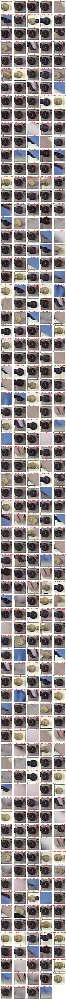

In [60]:
visualize_model_error(model,images_num=dataset_sizes['val'])

Indeed! many of the mistakes are on ocluded pieces. that means that on "clean" images are model performes quite well :)
we can see another problem that when the figure head is cropped the model get the classification wrong- which is natural. a possible fix for it is to change the cropping to have a pid of pad, that way pieces heads (which carry important information about figure type) will still be included in the picture . however this may cause a novel problem of 2 pieces appearing in one image, and confuse the model.
but lets return to the ocluded pieces. we want to see if the prediction made by the model for this pictures is Low confident -> if so we can threshold on the confidence and that way classify oclusions.
for that task we manually search the data base for ocluded pictures from the val dataset and for each we display the value of the max probability that is given to a class.

In [82]:
def visualize_model_confidence(
    model,
    val_loader,
    occluded_loader,
    val_num=5,
    occluded_num=5
):
    model.eval()

    samples = []
    idx_to_class = {idx: cls for cls, idx in image_datasets['train'].class_to_idx.items()}

    with torch.no_grad():
        # ---- validation samples ----
        for imgs, labels in val_loader:
            logits = model(imgs.to(device))
            probs = torch.softmax(logits, dim=1)
            confs, preds = probs.max(dim=1)

            for img, pred, conf, gt in zip(imgs, preds, confs, labels):
                samples.append((
                    img.cpu(),
                    pred.item(),
                    conf.item(),
                    gt.item(),
                    "VAL"
                ))
                if len([s for s in samples if s[4] == "VAL"]) >= val_num:
                    break
            if len([s for s in samples if s[4] == "VAL"]) >= val_num:
                break

        # ---- occluded samples ----
        for imgs, labels in occluded_loader:
            logits = model(imgs.to(device))
            probs = torch.softmax(logits, dim=1)
            confs, preds = probs.max(dim=1)

            for j, (img, pred, conf, gt)in enumerate(zip(imgs, preds, confs,labels)):
                print(gt)
                samples.append((
                    img.cpu(),
                    pred.item(),
                    conf.item(),
                    gt.item(),
                    "OCCLUDED"
                ))
                if len([s for s in samples if s[4] == "OCCLUDED"]) >= occluded_num:
                    break
            if len([s for s in samples if s[4] == "OCCLUDED"]) >= occluded_num:
                break

    # ---- plotting ----
    cols = max(val_num, occluded_num)
    rows = 2
    fig, axes = plt.subplots(rows, cols, figsize=(3 * cols, 6))

    for i, (img, pred, conf, gt, tag) in enumerate(samples):
        r = 0 if tag == "VAL" else 1
        c = i % cols
        ax = axes[r, c]

        ax.imshow(tensor_to_numpy_image(img))
        ax.axis("off")

        title = f"{idx_to_class[pred]} ({conf:.2f})"
        if gt is not None:
            title += f"\nGT: {idx_to_class[gt]}"
        ax.set_title(title, fontsize=9)

    axes[0, 0].set_ylabel("VAL", fontsize=12)
    axes[1, 0].set_ylabel("OCCLUDED", fontsize=12)

    plt.tight_layout()
    plt.show()


tensor(3)
tensor(0)
tensor(3)
tensor(5)
tensor(7)


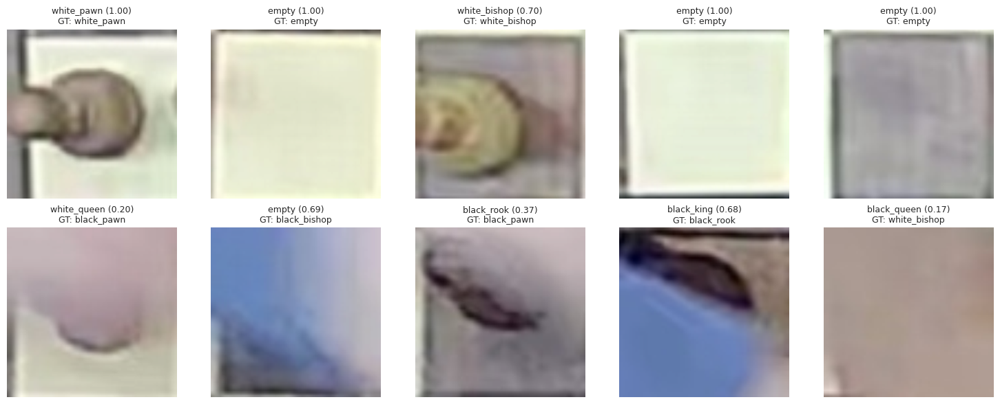

In [83]:
visualize_model_confidence(model, clean_dataloader,ocluded_dataloader,5,5)

BINNNNGOOOO!
confidence thresholding should work well here!

But lets make it more official
in front of you are the distribution of confidence for each "clean" piece class compared to the distribution of confidence of the ocluded images.
It comes to show that there is a margin between the confidences of the clean images (no matter what class they are) and the confidence of the ocluded images

In [53]:

def get_confidences(model, clean_dl, ocluded_dl, filter_correct_ocluded = True, filter_ocluded_empty = False):
    model.eval()

    clean_confs = []
    ocluded_confs = []
    empty_idx = image_datasets['train'].class_to_idx["empty"]
    with torch.no_grad():
        # ---- CLEAN ----
        for imgs, _ in tqdm(clean_dl):
            imgs = imgs.to(device)

            logits = model(imgs)
            probs = F.softmax(logits, dim=1)
            confs, _ = probs.max(dim=1)

            clean_confs.extend(confs.cpu().numpy())

        # ---- OCCLUDED ----
        for imgs, labels in tqdm(ocluded_dl):
            imgs = imgs.to(device)
            labels = labels.to(device)
            logits = model(imgs)
            probs = F.softmax(logits, dim=1)
            confs, preds = probs.max(dim=1)

            mask = torch.ones_like(confs, dtype=torch.bool)
            if filter_correct_ocluded:
                mask = mask & (preds != labels)
            if filter_ocluded_empty:
                mask = mask & (preds != empty_idx)
            confs = confs[mask]



            ocluded_confs.extend(confs.cpu().numpy())

    clean_confs = np.array(clean_confs)
    ocluded_confs = np.array(ocluded_confs)

    return clean_confs, ocluded_confs

def plot_conf_dist(clean_confs, ocluded_confs, title):

    sns.set_theme(style="white")

    plt.figure(figsize=(7, 4))

    sns.ecdfplot(
        clean_confs,
        label=f"clean (n={len(clean_confs)})",
        linewidth=2
    )

    sns.ecdfplot(
        ocluded_confs,
        label=f"occluded (n={len(ocluded_confs)})",
        linewidth=2
    )

    plt.xlim(0, 1)
    plt.xlabel("confidence")
    plt.ylabel("fraction ≤ x")
    plt.title(title)
    plt.legend()
    sns.despine()

    plt.show()



In [40]:
clean_confs, ocluded_confs = get_confidences(
    model,
    clean_dataloader,
    ocluded_dataloader,
    filter_correct_ocluded=True,
)



100%|██████████| 3/3 [00:00<00:00, 14.01it/s]


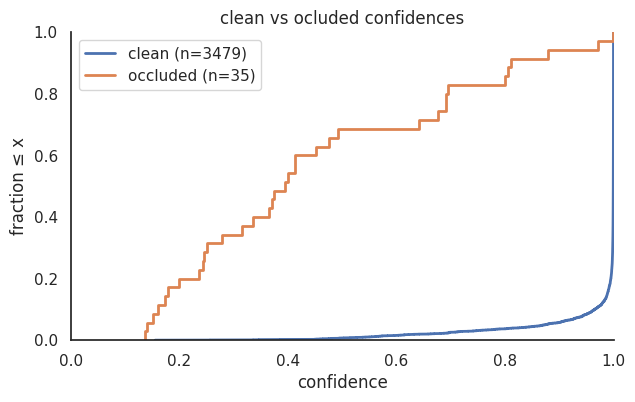

In [54]:
plot_conf_dist(clean_confs, ocluded_confs,"clean vs ocluded confidences")


In [89]:
def visualize_confident_occluded_errors(model,ocluded_dl,threshold=0.7,plot_width=5):
  model.eval()
  to_display_confs = []
  to_display_images = []
  to_display_labels = []
  to_display_preds = []

  idx_to_class = {idx: cls for cls, idx in image_datasets['train'].class_to_idx.items()}
  with torch.no_grad():
    for imgs, labels in ocluded_dl:
      imgs = imgs.to(device)
      labels = labels.to(device)
      logits = model(imgs)
      probs = F.softmax(logits, dim=1)
      confs, preds = probs.max(dim=1)
      mask_errors = (preds != labels)
      mask_threshold = (confs > threshold)
      mask = mask_errors & mask_threshold
      to_display_confs.extend(confs[mask].cpu().numpy())
      to_display_images.extend(imgs[mask].cpu())
      to_display_labels.extend(labels[mask].cpu().numpy())
      to_display_preds.extend(preds[mask].cpu().numpy())


   # Setup the plot grid
  cols = plot_width
  rows = (len(to_display_images)) // cols + 1  # Ceiling division to find needed rows

  fig = plt.figure(figsize=(3*cols, 3 * rows))

  for j,(img, pred, conf, gt) in enumerate(zip(to_display_images, to_display_preds, to_display_confs,to_display_labels)):
      ax = plt.subplot(rows, cols, j + 1)
      ax.axis('off')

      pred_class = idx_to_class[pred]
      actual_class = idx_to_class[gt]
      ax.set_title(
          f"P: {pred_class}\n"
          f"C: {conf:.2f}\n"
          f"A: {actual_class}",
          color="red",
          fontsize=9
      )
      # Ensure your tensor_to_numpy_image handles the C,H,W to H,W,C conversion
      image = tensor_to_numpy_image(img)
      ax.imshow(image)

  plt.tight_layout()
  plt.show()





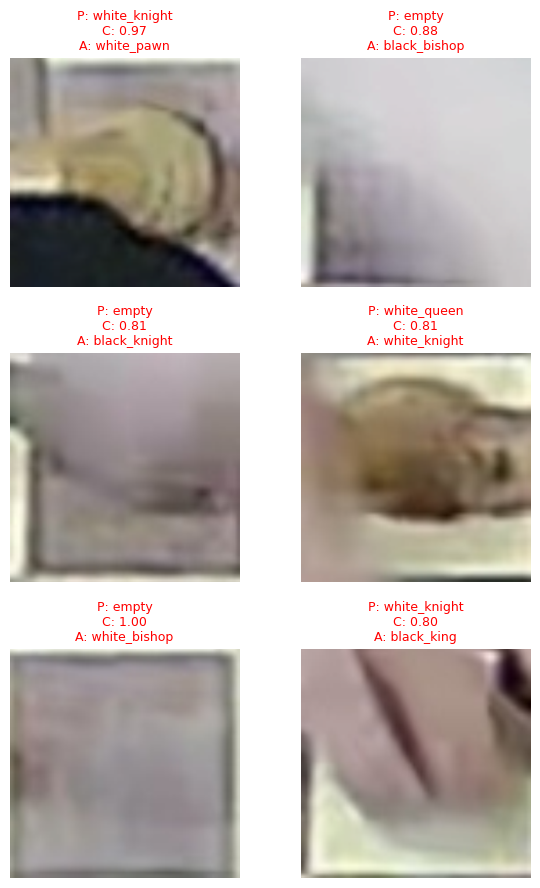

In [91]:
visualize_confident_occluded_errors(model,ocluded_dataloader, 0.8, 2)

100%|██████████| 3/3 [00:00<00:00, 14.41it/s]


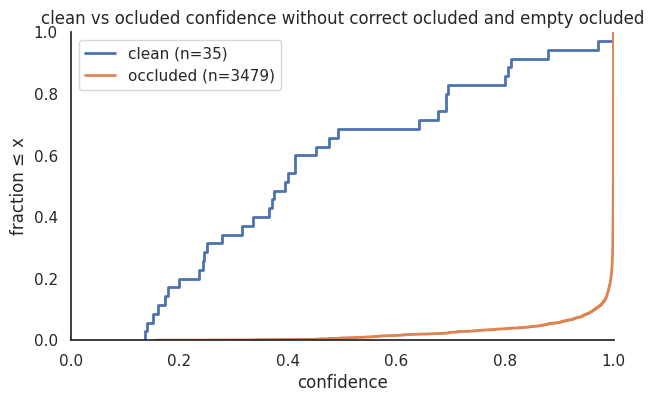

In [56]:
clean_confs, ocluded_confs = get_confidences(
    model,
    clean_dataloader,
    ocluded_dataloader,
    filter_correct_ocluded=True,
    filter_ocluded_empty=False,
)

plot_conf_dist(ocluded_confs,clean_confs,"clean vs ocluded confidence without correct ocluded and empty ocluded")

In [61]:
class InferenceDataset(torch.utils.data.Dataset):

    def __init__(self, image_paths):
        self.image_paths = image_paths
        self.transforms = transforms.Compose([transforms.Resize(224),
                          transforms.ToTensor(),
                          transforms.Normalize(imagenet_mean, imagenet_std)])

    def __getitem__(self, idx):
        image = self.images[idx]
        img = Image.open(self.image_paths[idx]).convert("RGB")
        return self.transform(img)


    def __len__(self):
        return len(self.image_paths)


In [57]:
print(image_datasets["train"].class_to_idx)

{'black_bishop': 0, 'black_king': 1, 'black_knight': 2, 'black_pawn': 3, 'black_queen': 4, 'black_rook': 5, 'empty': 6, 'white_bishop': 7, 'white_king': 8, 'white_knight': 9, 'white_pawn': 10, 'white_queen': 11, 'white_rook': 12}


In [ ]:
def classify(model, dataloader, confidence_threshold=0.8):
    """performs inference on the given data, is the confidence is below the confidence_threshold it is classified as ocluded (class index -1)"""
    model.eval()
    preds = []
    with torch.no_grad():
        for inputs in dataloader:
          inputs = inputs.to(device)
          outputs = model(inputs)
          probabilites = F.softmax(outputs,dim=1)
          _, batch_preds = torch.max(outputs, 1)
          confs, _ = probabilites.max(dim=1)
          mask = confs > confidence_threshold
          batch_preds[~mask] = -1 #
          preds.extend(batch_preds.cpu().numpy())
    return preds

In [74]:
def visualize_model_predictions(model, dataloader, num_pred, confidence_threshold=0.8):
    """Visualize up to num_pred predictions from the dataloader (early-stops inference)."""
    model.eval()

    idx_to_class = {idx: cls for cls, idx in image_datasets['train'].class_to_idx.items()}
    idx_to_class[-1] = "occluded"

    images_to_plot = []
    pred_labels_to_plot = []
    gt_labels_to_plot = []

    with torch.no_grad():
        for inputs,labels in dataloader:

            inputs = inputs.to(device)

            probs = torch.softmax(model(inputs), dim=1)
            confs, preds = probs.max(dim=1)

            preds = preds.clone()
            preds[confs < confidence_threshold] = -1

            pred_labels_cpu = [idx_to_class[p] for p in preds.cpu().tolist()]
            gt_labels_cpu = [idx_to_class[l] for l in labels.cpu().tolist()]

            images_to_plot.extend(inputs.cpu())
            pred_labels_to_plot.extend(pred_labels_cpu)
            gt_labels_to_plot.extend(gt_labels_cpu)

            if len(images_to_plot) >= num_pred:
                break


    # ---- plot ----
    plt.figure(figsize=(min(num_pred, 6) * 3, 3))

    for i, (img_t, pred_label, gt_label) in enumerate(
        zip(images_to_plot, pred_labels_to_plot, gt_labels_to_plot)
    ):
        img = tensor_to_numpy_image(img_t)

        plt.subplot(1, num_pred, i + 1)
        plt.imshow(img)
        plt.title(f"P: {pred_label}\nGT: {gt_label}", fontsize=10)
        plt.axis("off")
        if i == num_pred - 1:
            break
    plt.tight_layout()
    plt.show()

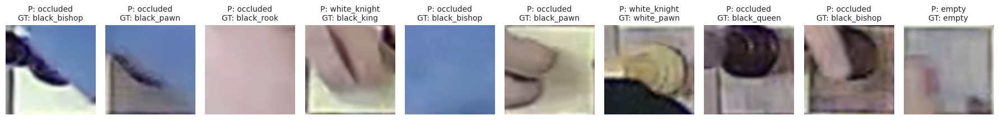

In [84]:
visualize_model_predictions(model, ocluded_dataloader, 10, 0.8)

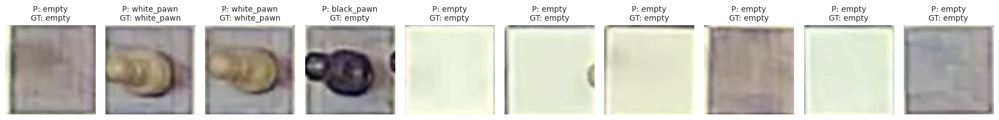

In [86]:
visualize_model_predictions(model, clean_dataloader, 10, 0.8)

Out Of Distribution Handling
ATTEMPT1 - Max softmax probability margin

no prior filtering of oclusions